Sensor 2 sending: (b'\xdfg\xfa\x12c\xab\xcaP2\xdd\xaf*\xad\x96B\x85\xb30\x08\xcdP\xef\xa8n\xc3\x9f\x0b)\x0c\xcdf \xcd\xc2(Q)\r\xdb\x97\xad\x14\xc9;\xea\r\x88\x0b\xd0\x8f\xf7"\x91\xa1\xcd\x83\xef7\xca\x8fH\xfd\x84-R5\xd1\x13\xdav\x86ya=l\xf0E\xb3a\x10s\xd1\x11uD\x166\xe7K\x86\xe6;>\xb6\xb2T\xb1\xaf\xbf(\xcc(\xea\x12t\xd6\xa5b\n\xed', b'}n\x9f\xb7PPr\x96\x8a\x8b\x83\x14\xb7*6O', b'p\x88\xda\xc23\xa3\x01\x94?:\nSxBBr', b'x\xa9\xb1wI\x9f\x0e\x87\xae~\x0ep\x03^P\x9f\xf3"\xe5\xd0\xd4\xb1\xbdy\x08\x1f\xce7\x0cME~v\xee\xed8\xb0!f/\xecE\xd9\xdf\xf8\x97_F\xf9\xb20-`q-\x07\x15t\x7f|\xdc\xcd\x1f\x91cyo\xa5\x94\x13\xce\x1bqO\xc8\x19,F\xbcL\x8aKS\xbf\xea\xdc\\3\x829\x1c\xe4\x1b\xe1\x9a1m\x8a5\x0b\xfb\xbe@\x0fj \xf7\x8d\x12S\x8d\xe8\x9d\x05\xbf\x1b{B\x1f(\xff\xfb\x06\x92\x9b\x1e\xac\xac\'\xb7N\\\x99SA\x85\x9aj/N]a\x9f\xc1\x04\xe2\xa9M\xccc\x08$\x82y\xa6\x90\xa2H\x9d\x9a\xcc\xc4<\xd9\x03U&E\x82N\xaf\xc9 \xb5K\xd8\x8c\xa2\x8f)ob\x9f\x19\xd4OT\x08\xaf~F\xbdXn9Z\xd8\xec^\xd17\xd3L\xec\xa5\x8cn\xfc\x81D5B

['C:\\Users\\YANSILIYU\\devProject\\replay\\processed_tasks.png',
 'C:\\Users\\YANSILIYU\\devProject\\replay\\successful_attacks.png',
 'C:\\Users\\YANSILIYU\\devProject\\replay\\attacks_dropped.png',
 'C:\\Users\\YANSILIYU\\devProject\\replay\\resource_utilization.png',
 'C:\\Users\\YANSILIYU\\devProject\\replay\\average_processing_time_(ms).png',
 'C:\\Users\\YANSILIYU\\devProject\\replay\\detection_rate.png']

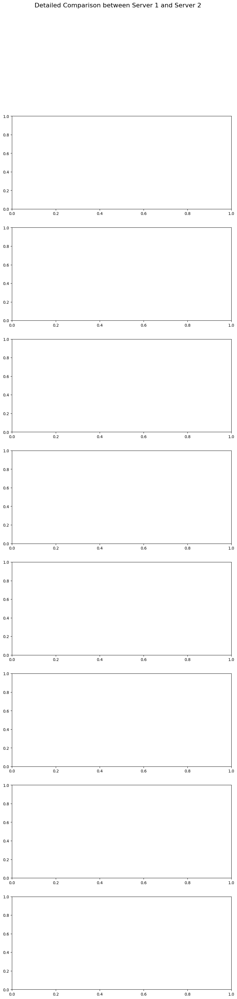

In [4]:
# Parameters for the servers
CPU = 2.9  # GHz
Cores = 4
RAM = 4  # GB
Capacity = 500  # GB

from Crypto.Cipher import AES, PKCS1_OAEP
from Crypto.Random import get_random_bytes
import random
import time
import threading
import pandas as pd
import matplotlib.pyplot as plt
from Crypto.PublicKey import RSA

private_key = RSA.generate(2048)
public_key = private_key.publickey()

def hybrid_rsa_aes_encryption(data, public_key):
    # Generate a random AES key
    aes_key = get_random_bytes(16)

    # Encrypt the data with AES
    cipher_aes = AES.new(aes_key, AES.MODE_EAX)
    ciphertext, tag = cipher_aes.encrypt_and_digest(data)

    # Encrypt the AES key with RSA
    cipher_rsa = PKCS1_OAEP.new(public_key)
    cipher_key = cipher_rsa.encrypt(aes_key)

    return (ciphertext, tag, cipher_aes.nonce, cipher_key)

def hybrid_rsa_aes_decryption(ciphertext, tag, nonce, cipher_key, private_key):
    # Decrypt the AES key with RSA
    cipher_rsa = PKCS1_OAEP.new(private_key)
    aes_key = cipher_rsa.decrypt(cipher_key)

    # Decrypt the data with AES
    cipher_aes = AES.new(aes_key, AES.MODE_EAX, nonce=nonce)
    data = cipher_aes.decrypt_and_verify(ciphertext, tag)

    return data

class Sensor:
    def __init__(self, sensor_id):
        self.sensor_id = sensor_id

    def generate_task(self):
        timestamp = time.time()
        task_complexity = random.choice([5, 10, 15, 20, 25, 30, 40, 45])  # Complexity in MB
        return {'sensor_id': self.sensor_id, 'timestamp': timestamp, 'task_complexity': task_complexity, 'send_timestamp': timestamp}

    def encrypt_task(self):
        task = self.generate_task()
        serialized_task = str(task).encode('utf-8')
        encrypted_task = hybrid_rsa_aes_encryption(serialized_task, public_key)
        return encrypted_task

class Attacker:
    def __init__(self, attacker_id, servers):
        self.attacker_id = attacker_id
        self.servers = servers

    def intercept_task(self, task, sender):
        # The attacker intercepts the task
        intercepted_task = task
        # The attacker waits for 1.5 seconds before resending the intercepted task
        time.sleep(1.5)
        # The attacker resends the intercepted task to a random server
        target_server = random.choice(self.servers)
        target_server.process_task(intercepted_task, f"Attacker {self.attacker_id}")

class Server:
    def __init__(self, server_id, private_key, cpu, cores, ram, capacity, with_detection_mechanism=True):
        self.server_id = server_id
        self.private_key = private_key
        self.cpu = cpu
        self.cores = cores
        self.ram = ram
        self.capacity = capacity
        self.with_detection_mechanism = with_detection_mechanism
        self.received_tasks = set()
        self.successful_tasks = 0
        self.successful_attacks = 0
        self.successful_attacks_dropped = 0
        self.start_time = time.time()
        self.end_time = None
        self.processing_units_used = 0 
        self.processed_tasks = 0  
        self.latest_timestamp = 0
        self.successful_attacks_detected = 0
        self.processing_times = []

    def compute_processing_time(self, task_complexity):
        base_time = task_complexity / 10.0  
        cpu_factor = 2.9 / self.cpu
        core_factor = 4 / self.cores
        ram_factor = 4 / self.ram
        capacity_factor = 500 / self.capacity
        return base_time * cpu_factor * core_factor * ram_factor * capacity_factor

    def process_task(self, task, sender):
        start_time = time.time()
        decrypted_task = hybrid_rsa_aes_decryption(*task, self.private_key)
        original_task = decrypted_task.decode('utf-8')
        task_content = eval(original_task)
        
        timestamp = task_content['timestamp']
        task_complexity = task_content['task_complexity']
        if (timestamp, sender) not in self.received_tasks:
            self.received_tasks.add((timestamp, sender))
            self.successful_tasks += 1

            if "Attacker" in sender:
                self.successful_attacks += 1

            if self.with_detection_mechanism and "Attacker" in sender:
                self.successful_attacks_dropped += 1
                if self.detect_attack(timestamp):
                    self.successful_attacks_detected += 1
                    print(f"Server {self.server_id} detected an attack and dropped the task.")
                    return  # Drop the compromised task

            self.processed_tasks += 1
            self.processing_units_used += task_complexity / 100.0  # Simulate resource usage
            print(f"Server {self.server_id} received task with complexity {task_complexity} MB from {sender}")
        
        processing_time = self.compute_processing_time(task_complexity)
        time.sleep(processing_time)
        end_time = time.time()  # End timing the processing
        processing_time_ms = (end_time - start_time) * 1000  # Convert to milliseconds
        self.processing_times.append(processing_time_ms)

    def detect_attack(self, timestamp):
        # Detect potential replay attacks by checking if the timestamp is significantly older than the latest timestamp
        current_time = time.time()
        if current_time - timestamp > 1:  # Threshold of 1 second to consider it an attack
            return True
        return False
    
    def calculate_average_processing_time(self):
        if self.processed_tasks > 0:
            return sum(self.processing_times) / len(self.processing_times)
        return 0

    def calculate_resource_utilization(self):
        return self.processing_units_used

def simulate_sensor(sensor, servers, attackers, interception_probability):
    for _ in range(100):
        target_server = random.choice(servers)
        encrypted_task = sensor.encrypt_task()
        print(f"Sensor {sensor.sensor_id} sending: {encrypted_task}")

        if random.random() < interception_probability:  # Dynamic interception chance
            attacker = random.choice(attackers)
            attacker.intercept_task(encrypted_task, f"Sensor {sensor.sensor_id}")
        else:
            target_server.process_task(encrypted_task, f"Sensor {sensor.sensor_id}")

def compile_metrics_to_dataframe(servers, interception_probability):
    # Initialize an empty list to hold the data for each server
    data = []

    # Compile metrics for each server
    for server in servers:
        resource_utilization = server.calculate_resource_utilization()
        average_processing_time = server.calculate_average_processing_time()
        detection_rate = server.successful_attacks_detected / server.successful_attacks * 100 if server.successful_attacks > 0 else 0
        
        # Add the server's metrics to the data list
        data.append({
            'Interception Probability': interception_probability,
            'Server ID': server.server_id,
            'Processed Tasks': server.processed_tasks,
            'Successful Attacks': server.successful_attacks,
            'Attacks Dropped': server.successful_attacks_dropped,
            'Resource Utilization': f"{resource_utilization:.2f}",
            'Average Processing Time (ms)': f"{average_processing_time:.2f}",
            'Detection Rate': f"{detection_rate:.2f}%"
        })

    # Convert the list of data into a pandas DataFrame
    return pd.DataFrame(data)

def main():
    interception_probabilities = [0.1, 0.2, 0.3, 0.4, 0.5]
    metrics_list = []  # Collect data as a list of dictionaries

    for interception_probability in interception_probabilities:
        # Initialize or reset sensors, servers, and attackers for each probability run
        sensors = [Sensor(sensor_id) for sensor_id in range(1, 51)]
        servers = [
            Server(server_id=1, private_key=private_key, cpu=CPU, cores=Cores, ram=RAM, capacity=Capacity, with_detection_mechanism=True),
            Server(server_id=2, private_key=private_key, cpu=CPU, cores=Cores, ram=RAM, capacity=Capacity, with_detection_mechanism=False)
        ]
        attackers = [Attacker(attacker_id, servers) for attacker_id in range(1, 6)]
        
        threads = []
        for sensor in sensors:
            thread = threading.Thread(target=simulate_sensor, args=(sensor, servers, attackers, interception_probability))
            threads.append(thread)
            thread.start()
        
        for thread in threads:
            thread.join()
        
        # Compile metrics for this interception probability
        metrics_df = compile_metrics_to_dataframe(servers, interception_probability)
        
        # Convert each row in the metrics DataFrame to a dictionary and add it to the list
        for _, row in metrics_df.iterrows():
            metrics_list.append(row.to_dict())
    
    # Convert the list of dictionaries to a DataFrame
    final_metrics_df = pd.DataFrame(metrics_list)
    
    # Display the final DataFrame
    final_metrics_df.to_csv('performance_metrics.csv')

if __name__ == "__main__":
    main()

metrics_table = pd.read_csv('performance_metrics.csv')
metrics_table
# Define path for saving images
save_path = 'C:\\Users\\YANSILIYU\\devProject\\replay\\'

# Filtering data by Server ID
server1 = metrics_table[metrics_table['Server ID'] == 1]
server2 = metrics_table[metrics_table['Server ID'] == 2]

# Setting up figure dimensions
fig, axes = plt.subplots(8, 1, figsize=(10, 40))
fig.suptitle('Detailed Comparison between Server 1 and Server 2', fontsize=16)

metrics = [
    'Processed Tasks', 'Successful Attacks', 
    'Attacks Dropped', 'Resource Utilization', 
    'Average Processing Time (ms)', 'Detection Rate'
]

# Plotting and saving individual graphs
for metric in metrics:
    fig, ax = plt.subplots(figsize=(10, 5))
    ax.plot(server1['Interception Probability'], server1[metric], label='Server with TimeStamp Detection Mechanism')
    ax.plot(server2['Interception Probability'], server2[metric], linestyle='--', label='Server without TimeStamp Detection Mechanism')
    ax.set_title(f'{metric} Comparison')
    ax.set_xlabel('Interception Probability')
    ax.set_ylabel(metric)
    ax.legend()
    # Save each plot as a separate file
    file_path = f'{save_path}{metric.replace(" ", "_").lower()}.png'
    plt.savefig(file_path)
    plt.close()  # Close the plot to free up memory

# Return the paths of saved files
saved_files = [f'{save_path}{metric.replace(" ", "_").lower()}.png' for metric in metrics]
saved_files
